In [1]:
import torch 
import torch.nn as nn
import torch.optim as optim 
from torch.optim import lr_scheduler
import torchvision 
from torchvision import datasets, models, transforms
from torchvision.models import ResNet18_Weights

import os
import time
from PIL import Image
import numpy as np

import matplotlib.pyplot as plt

In [2]:
! python -m pip install torch
! python -m pip install torchvision
! python -m pip install matplotlib

In [3]:
# Define required data transforms 
data_transforms = {
    'train' : transforms.Compose([
        transforms.RandomHorizontalFlip(p=0.25),
        transforms.RandomVerticalFlip(p=0.25),
        transforms.ToTensor()
    ]),
    'val' : transforms.Compose([
        transforms.RandomHorizontalFlip(p=0.25),
        transforms.RandomVerticalFlip(p=0.25),
        transforms.ToTensor()
    ])}

# Create train/val datasets/dataloaders
data_dir = 'painting_image_data/'
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x]) for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4, shuffle=True, num_workers=4) for x in ['train', 'val']}

dataset_sizes = {x: len(image_datasets[x])for x in ['train', 'val']}
class_names = image_datasets['train'].classes

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'used device: {device}')

used device: cpu


In [4]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=2):
    since = time.time()

    # Create a ckpts directory to save training checkpoints
    best_model_params_path = os.path.join('ckpts/', 'renaissance_v1.pt')

    torch.save(model.state_dict(), best_model_params_path)
    best_acc = 0.0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                torch.save(model.state_dict(), best_model_params_path)

        print()

    time_elapsed = time.time() - since
    print(f'Training time: {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best validation accuracy: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(torch.load(best_model_params_path))
        
    return model

In [ ]:
# # Define model instance with pretrained weights 
# weights = ResNet18_Weights.DEFAULT
# model = models.resnet18(weights=weights)

# # Change shape of model head 
# fc_in_features = model.fc.in_features
# fc_out_features = len(class_names)
# model.fc = nn.Linear(in_features=fc_in_features, 
#                      out_features=fc_out_features)

# # Specify model device
# model = model.to(device=device)

# # Define classification model loss function (criterion)
# criterion = torch.nn.CrossEntropyLoss() 

# # Define optimizer 
# optimizer = torch.optim.SGD(model.parameters(),
#                             lr=1e-2)

# # Define learning rate scheduler 
# lr_scheduler = lr_scheduler.StepLR(optimizer=optimizer,
#                                    step_size=5,
#                                    gamma=0.1)

# # Define number of epochs
# num_epochs = 4

# # Train model 
# model = train_model(model=model,
#                     criterion=criterion,
#                     optimizer=optimizer,
#                     scheduler=lr_scheduler,
#                     num_epochs=num_epochs)

In [5]:
# Define model instance with pretrained weights 
weights = ResNet18_Weights.DEFAULT
model = models.resnet18(weights=weights)

# Change shape of model head 
fc_in_features = model.fc.in_features
fc_out_features = len(class_names)
model.fc = nn.Linear(in_features=fc_in_features, 
                     out_features=fc_out_features)

# Load state_dict
state_dict_path = 'ckpts/renaissance_v1.pt'     
model.load_state_dict(torch.load(state_dict_path))
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [6]:
# Create test dataset
test_image_path = 'painting_image_test/test_standardized/'
test_dataset = datasets.ImageFolder(test_image_path, transform=transforms.ToTensor())
test_class_names = test_dataset.classes
test_class_names

['Genre', 'Landscape', 'Naturmort', 'Portrait']

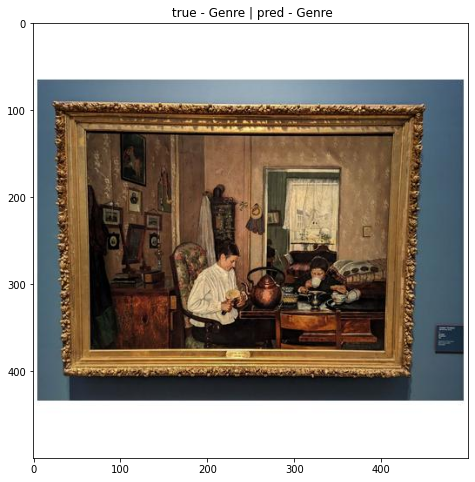

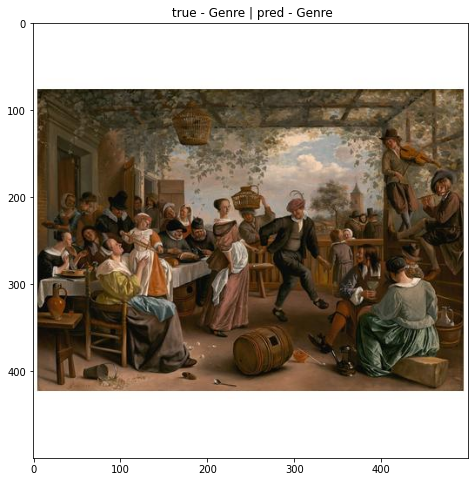

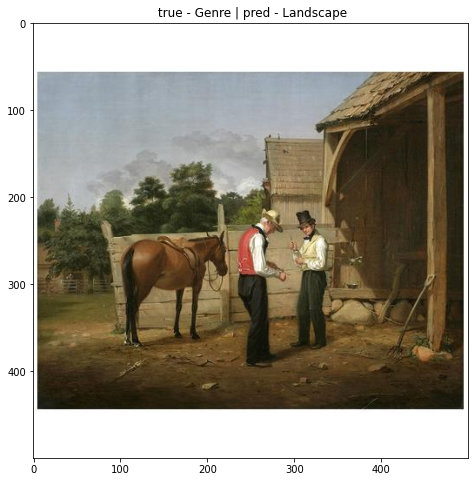

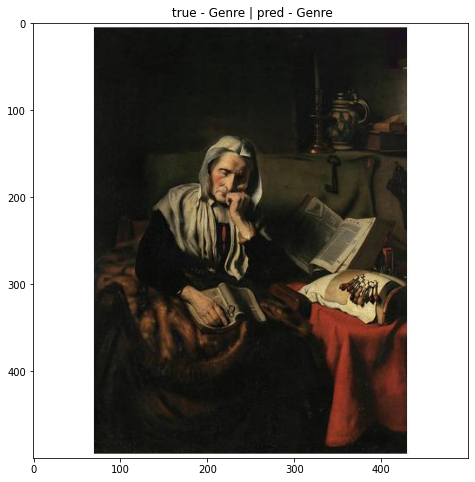

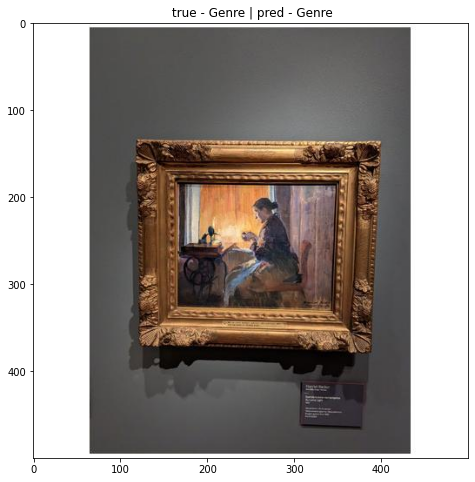

...

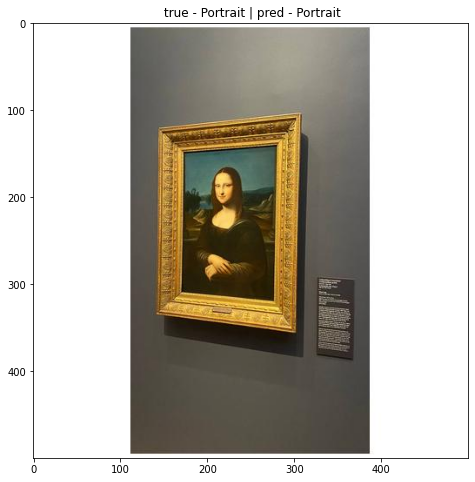

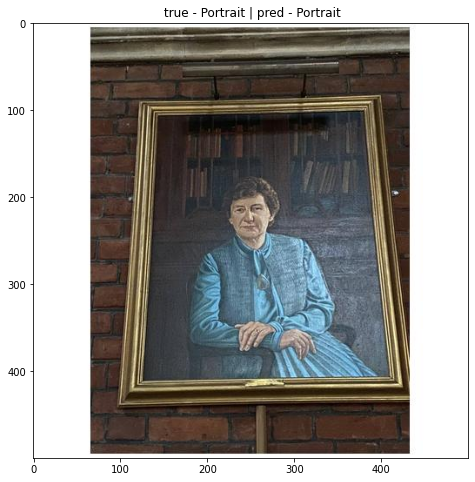

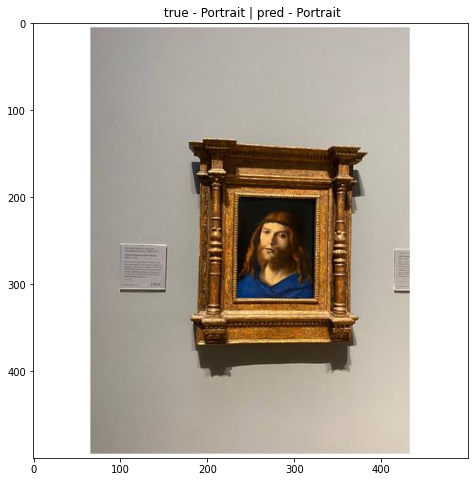

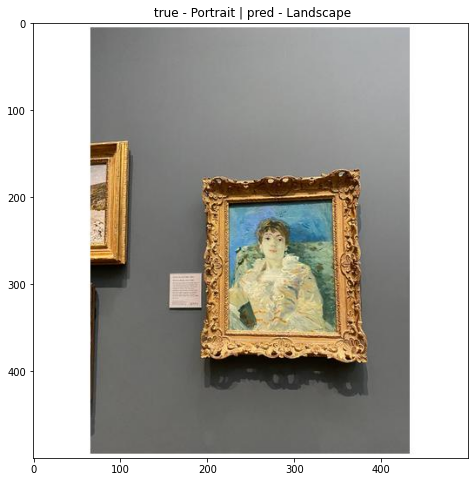

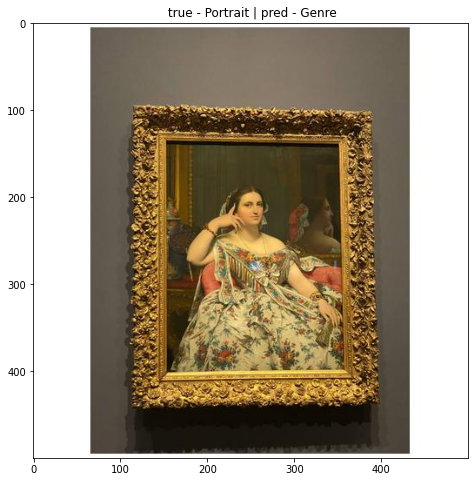

total: 100 | correctly classfied: 91 | Accuracy: 0.91


In [7]:

pass_counter = 0

with torch.inference_mode():
    for index, (image, label) in enumerate(test_dataset):
        
        # Make prediction
        prediction = model(image.unsqueeze(0))
        _, preds = torch.max(prediction, 1)

        pred_class = class_names[preds.numpy()[0]]
        true_class = class_names[label]
        file_path = test_dataset.imgs[index][0]
        title = f' true - {true_class} | pred - {pred_class}'

        # Check if predicted class is correct
        if true_class == pred_class:
            pass_counter += 1

        # Show prediction
        image = Image.open(file_path, 'r')
        plt.figure(figsize=(10, 8))
        plt.imshow(image)
        plt.title(title)
        plt.show()

# Print statistics
print(f'total: {len(test_dataset)} | correctly classfied: {pass_counter} | Accuracy: {pass_counter/len(test_dataset)}')

In [ ]:
# Best model
# total: 100 | correctly classfied: 91 | Accuracy: 0.91